# SEEP Segmentation Task

**Objective:** To segment seeps in SAR images

## 1. Exploratory Data Analysis(EDA)

Here, the goal is to gain insights into the data, identify patterns, and mask informed modeling decisions.

1.1. Check Environment

First, we'll need to run all of this in a virtual enviornmnet, so that it is reproducible.

In [2]:
import sys
sys.executable

'/Users/jeffreyjoan1/Downloads/seep_detection/seep/bin/python'

1.2. Load libraries and other helper functions

In [3]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import shutil
from pathlib import Path

In [4]:
from tqdm import tqdm
import os

In [1]:
from plot import hist_lee_plot_image, process_and_plot_image, plot_lee_filters, plot_poly_overlay_with_bounding_box, plot_image_and_mask, plot_image_label_distribution, plot_images_and_masks, plot_a_plot, plot_predictions_labels, plot_test_curves
from utils import mask_to_polygons_multi, split_dataset, process_mask_images_to_poygon_txt, create_dataset_df, move_files

In [6]:
from data_augmentation import instance_augmentation

In [7]:
from preprocess import preprocess_hist_lee, process_dir_save, convert_labels_to_single_seep

The following pair of image & mask is used cause it has good balance of labels, noise and distinguishable seeps. Which is helpful for visualisation.

In [8]:
image_path = 'train_images_256/041872.000023.tif'
mask_path = 'train_masks_256/041872.000023.tif'

In [9]:
image_array = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)
image_array.shape

(256, 256)

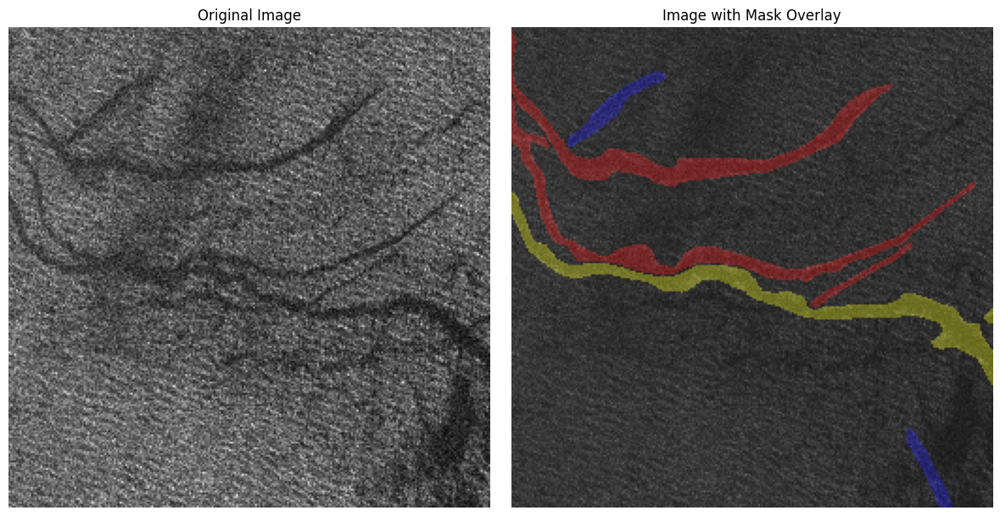

In [23]:
plot_image_and_mask(image_array, cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE))

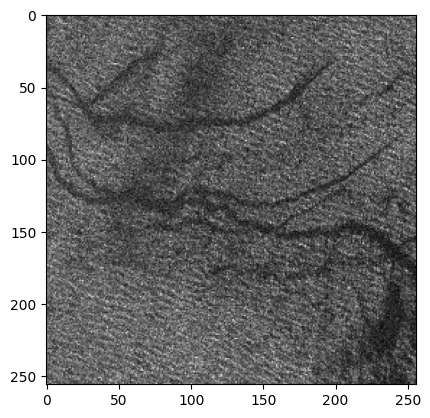

In [10]:
plt.imshow(image_array, cmap='gray')

Although, the above image has some distinguishable seeps. It seems to have a lot of noise.

Now, to verify the dimension of the image and the datatype

In [11]:
image_array.shape, image_array.dtype

((256, 256), dtype('uint16'))

The following code verifies that the pixel values are properly distributed across channels when read as RGB. This information is helpful to make an informed decision in the later stage of the modeling.

In [12]:
sum(sum(cv2.imread(image_path)[:,:,0] != cv2.imread(image_path)[:,:,1])) 
+ sum(sum(cv2.imread(image_path)[:,:,0] != cv2.imread(image_path)[:,:,2]))
+ sum(sum(cv2.imread(image_path)[:,:,0] != cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)))

0

Now, to observe how the seep instances are distributed across the images

In [13]:
np.unique(cv2.imread(mask_path), return_counts=True)

(array([0, 1, 2, 6], dtype=uint8), array([174480,  12402,   2250,   7476]))

In [18]:
np.unique(cv2.imread('train_masks_256/041872.000084.tif'), return_counts=True)

(array([0], dtype=uint8), array([196608]))

In [20]:
np.unique(cv2.imread('train_masks_256/045594.000175.tif'), return_counts=True)

(array([0, 4], dtype=uint8), array([196179,    429]))

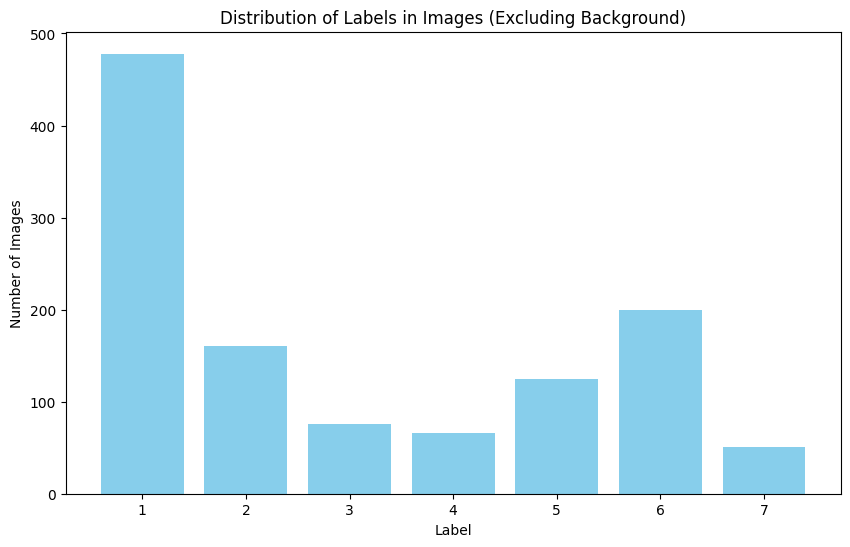

In [21]:
plot_image_label_distribution("train_masks_256/")

Assumptions that can be made from observing the data,

- An image may contain no seeps at all (mask would be all zeros)
- An image may contain a single seep of one type
- An image may contain multiple seeps of the same type
- An image may contain multiple seeps of different types
- Data is very imbalanced with overwhelming number of label-1 seep
- Both, images and masks are made of np.uint16 which has higher precision than most images

## 2. Preprocessing

SAR images are a bit tricky and different from images captured from a conventional camera. 

2.1. General image preprocessing

So, first I did some standard image processing like,

- Histogram Equalization
- Adaptive Histogram Equalization
- Gaussian Filter
- Bilateral Filter
- Inverted Image
- Normalised Image

In [12]:
image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)

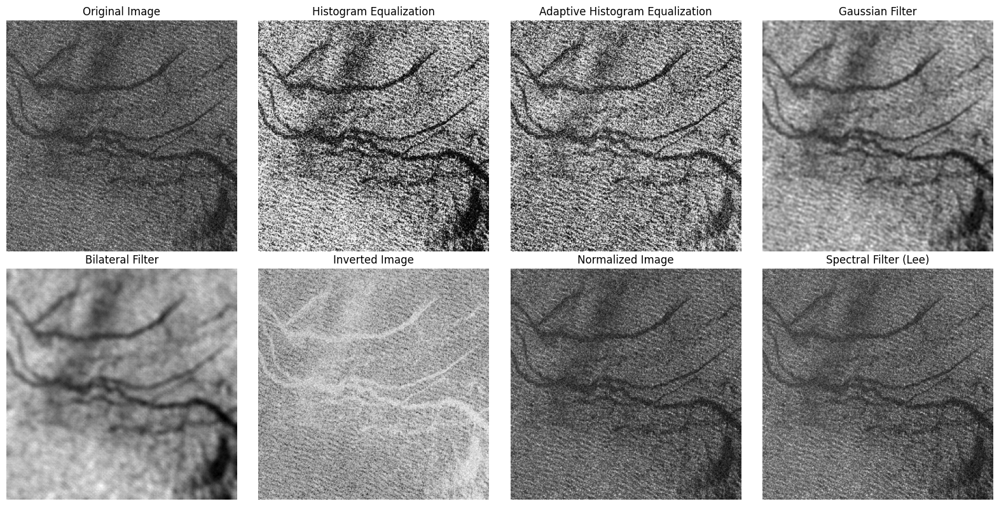

In [13]:
process_and_plot_image(image)

Here, the histogram equalisation makes the seeps more distinguishable. However, Gaussian and Bilateral filter make the image more blurry.

2.2. SAR Specific image processing

I made use of this document to learn more about SAR image preprocessing, https://www.earthdata.nasa.gov/s3fs-public/imported/pre-processing_onepager_ROUGH.pdf

I wanted to preserve the resolution of the image. So I went ahead with Speckle Filtering(Lee)

The following plot shows the difference between Lee Speckle Filtering of different filter sizes

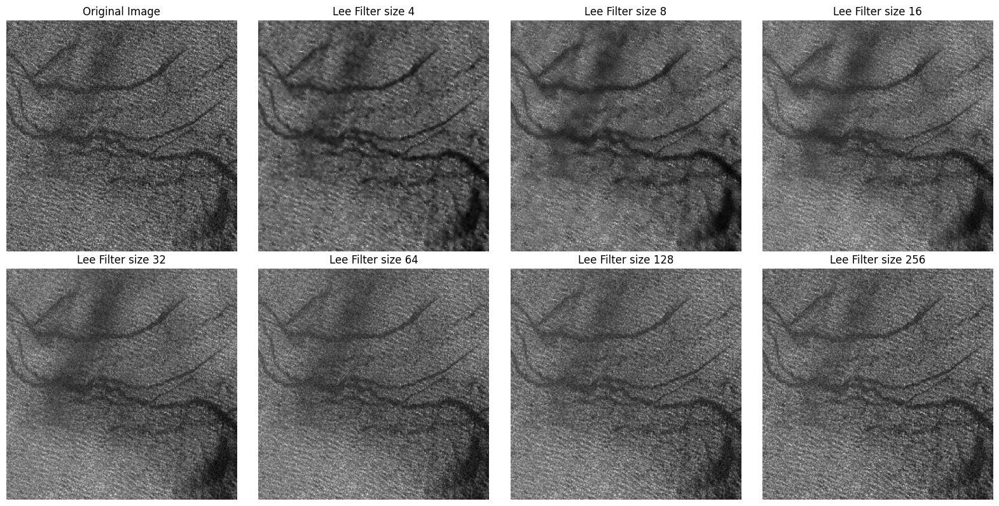

In [14]:
plot_lee_filters(image)

From the above observation, it is clear to see that the edges of the seep and the overall image is blurry for lower filter sizes

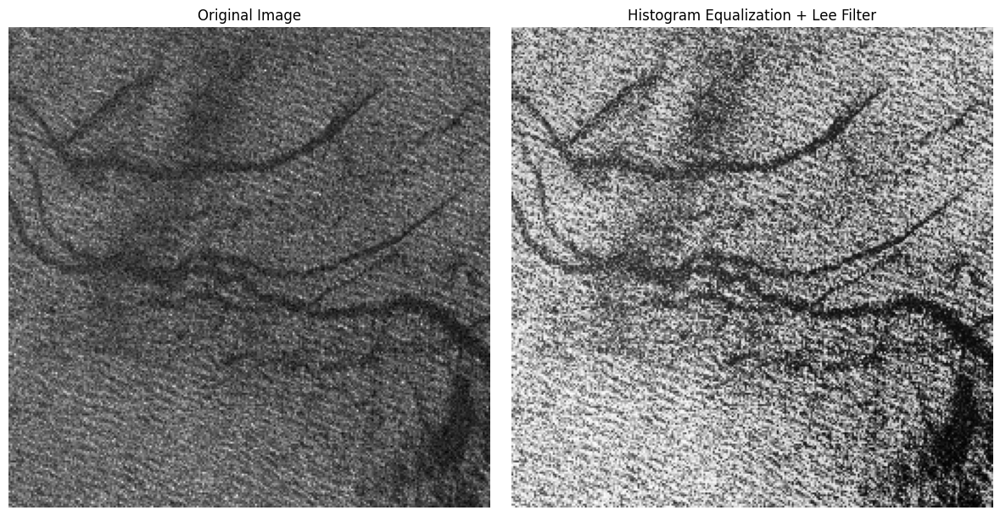

In [15]:
hist_lee_plot_image(image, size=256)

When histogram equalization and lee filter are combined for preprocessing. The edges are more distint and the noise is less

This is an ideal scenario.

## 3. Model Selection

Segmentation tasks can be broadly split into two categories:
- Semantic Segmentation: Aims to classify each pixel in an image into predefined categories or classes
- Instance Segmentation: Goes a step further by not only classifying pixels but also distinguishing between individual instances of objects

Although, semantic segmentation would work for our main task. I believe that instance segmnetation would be better suited, because the gap between some seeps of different labels are negligible. And there are multiple instances of the same seep within an image.

There are various models available to do instance segmentation. The popular ones are,
- Mask R-CNN: Two-stage detector. Extends Faster R-CNN by adding a branch for predicting segmentation masks on each Region of Interest
- YOLOv8: One-stage detector. Generally used for object detection. But also has instance segmentation capabilities.

Mask R-CNN might be a bit more accurate but YOLOv8 is much faster. 

Here, I am using YOLOv8 because,
- Mask R-CNN performs poorly for thin and long instances(https://arxiv.org/pdf/2203.03886)
- YOLOv8 has great support for data-augmentation which is going to be crucial for our task
- I am familiar with it's architecture
- I believe a object-detection based network would be better for the objective. Given the structure of the data & labels  

## 4. YOLOv8

Here, I've used 'YOLOv8l-seg'. Because I am fine with an overparametirized model. But I do not want a model that may underfit. 

The large variant has very good results against COCO and is only marginally less accurate that the 'xl' variant

YOLO models expect the input mask to be polygons(3 or 5 (x,y) point). The following function extracts the polygons from the given mask and plots it with the bounding box

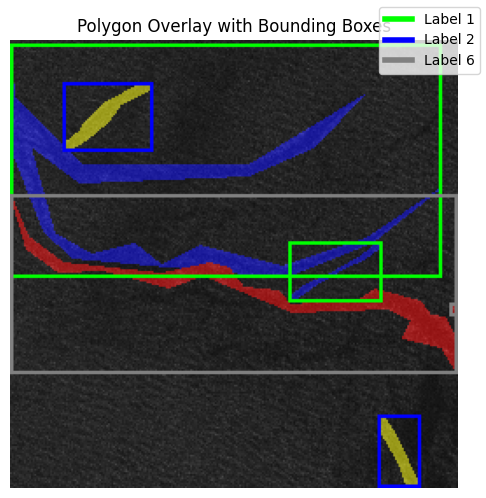

In [17]:
plot_poly_overlay_with_bounding_box(image, mask)

As you can see from the above image, some of the smooth edge information is lost

## 5. Data Augmentation

Although, YOLOv8 offers plenty of data-augmentation methods(Mosaic, MixUp). These methods build on top of pre-existing images and labels by combining them.

But, I want to increase the size of the original dataset. So, Since there are some images with several masks, I can extract them seperately and add them on top of a plain SAR image.

The following blocks of code implement that idea.

In [24]:
image_dir = "train_images_256/"
mask_dir = "train_masks_256/"
output_image_dir = "data_aug/images/"
output_mask_dir = "data_aug/masks/"

In [20]:
instance_augmentation(image_dir, mask_dir, output_image_dir, output_mask_dir)

In [21]:
file_names = ['041872.000023.tif', '041872.000023.1.tif', '041872.000023.2.tif', '041872.000023.6.tif' ]
images = []
masks = []

for count,i in enumerate(file_names):
    if count==0: 
        images.append(cv2.imread(image_dir+i))
        masks.append(cv2.imread(mask_dir+i, cv2.IMREAD_GRAYSCALE))
    else:
        images.append(cv2.imread(output_image_dir+i))
        masks.append(cv2.imread(output_mask_dir+i, cv2.IMREAD_GRAYSCALE))

In [25]:
np.unique(cv2.imread(mask_path), return_counts=True)

(array([0, 1, 2, 6], dtype=uint8), array([174480,  12402,   2250,   7476]))

In [22]:
for i in masks:
    print(np.unique(i, return_counts=True))

(array([0, 1, 2, 6], dtype=uint8), array([58160,  4134,   750,  2492]))
(array([0, 1], dtype=uint8), array([61402,  4134]))
(array([0, 2], dtype=uint8), array([64786,   750]))
(array([0, 6], dtype=uint8), array([63044,  2492]))


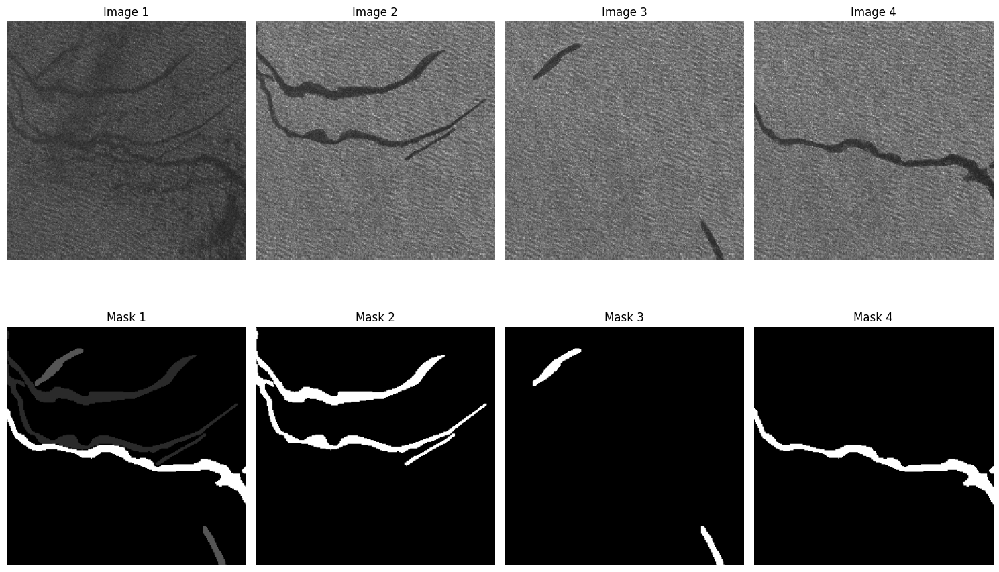

In [23]:
plot_images_and_masks(images, masks)

As noticed in the above plot, the first column corresponds to the original. The next three are generated from that singular pair of image.

## 6. Processing Directories

In [29]:
input_dir = 'data_aug/masks'
output_dir = 'data_aug/labels'

process_mask_images_to_poygon_txt(input_dir, output_dir)

In [30]:
input_dir = 'train_masks_256'
output_dir = 'train_labels_256'

process_mask_images_to_poygon_txt(input_dir, output_dir)

In [31]:
input_dir = 'datasets/masks/train'
output_dir = 'datasets/labels/train'

process_mask_images_to_poygon_txt(input_dir, output_dir)

In [32]:
input_dir = 'datasets/masks/val'
output_dir = 'datasets/labels/val'

process_mask_images_to_poygon_txt(input_dir, output_dir)

In the above code cells, we have processed all the masks to labels

In [33]:
process_dir_save('train_images_256', 'all_data/preprocessed_images')

/Users/jeffreyjoan1/Downloads/seep_detection/seep/lib/python3.10/site-packages/skimage/_shared/utils.py:438: UserWarning: This might be a color image. The histogram will be computed on the flattened image. You can instead apply this function to each color channel, or set channel_axis.
  return func(*args, **kwargs)


Processed 790 images


In the above cells, we preprocess all the image in the directory using histogram equalisation and Lee filter to remove speckle. We also save the images as 3-channel RGB images.

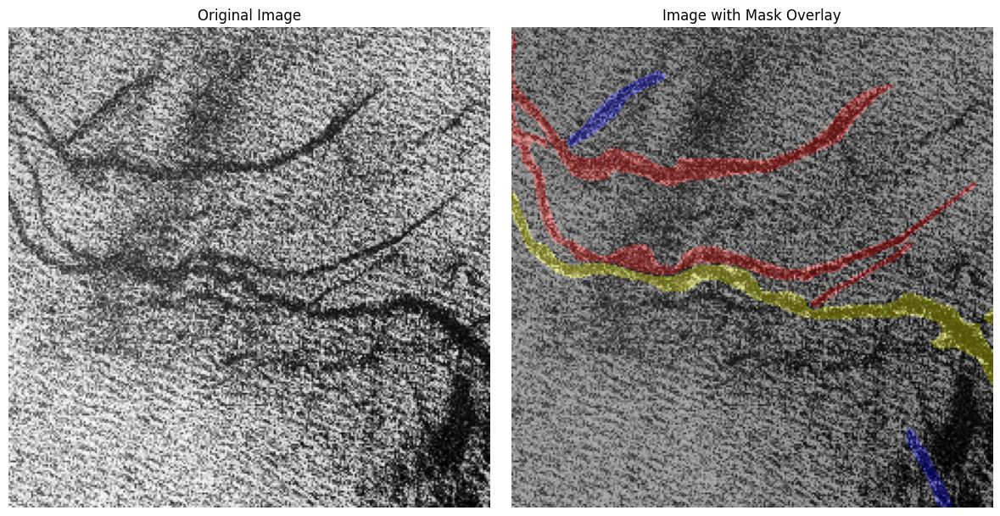

In [35]:
plot_image_and_mask(cv2.imread('preprocessed_images/041872.000023.png'), mask)

In [39]:
process_dir_save('data_aug/images', 'all_data/preprocessed_images')

/Users/jeffreyjoan1/Downloads/seep_detection/seep/lib/python3.10/site-packages/skimage/_shared/utils.py:438: UserWarning: This might be a color image. The histogram will be computed on the flattened image. You can instead apply this function to each color channel, or set channel_axis.
  return func(*args, **kwargs)


Processed 650 images


In [42]:
! cp train_masks_256/* all_data/masks/

In [43]:
! cp data_aug/masks/* all_data/masks/

In [44]:
! cp train_labels_256/* all_data/labels/

In [45]:
! cp data_aug/labels/* all_data/labels/

We move all the data(original data and augmented data) to a singular directory. So that it is convenient for splitting data

## 7. Data Splitting

Creating a pandas df makes it convenient to call the train_test_split. So that is what we are doing here.

The train:val:test split is 80:15:5

In [ ]:
base_directory = 'all_data'

df = create_dataset_df(base_directory)
print(df.head())
print(f"Total rows: {len(df)}")

In [4]:
train, val, test = split_dataset(df)

print(f"Train set: {len(train)} samples")
print(f"Validation set: {len(val)} samples")
print(f"Test set: {len(test)} samples")


Train set: 1390 samples
Validation set: 246 samples
Test set: 87 samples


In [5]:
test

,label_file,image_file,label
1199,labels/041874.000005.txt,preprocessed_images/041874.000005.png,0
1275,labels/041869.000043.txt,preprocessed_images/041869.000043.png,2
1248,labels/045553.000026.txt,preprocessed_images/045553.000026.png,0
1258,labels/041872.000025.2.txt,preprocessed_images/041872.000025.2.png,1
1319,labels/045551.000209.txt,preprocessed_images/045551.000209.png,1
...,...,...,...
1066,labels/041871.000165.txt,preprocessed_images/041871.000165.png,2
1162,labels/045594.000130.txt,preprocessed_images/045594.000130.png,2
286,labels/045591.000068.1.txt,preprocessed_images/045591.000068.1.png,0
505,labels/041870.000103.txt,preprocessed_images/041870.000103.png,0


In [7]:
move_files(train, base_directory, os.path.join('split_data', 'train'))
move_files(val, base_directory, os.path.join('split_data', 'val'))
move_files(test, base_directory, os.path.join('split_data', 'test'))

## 8. YOLO directory structure

The Following blocks of code organise the data and directory in the format suitable for YOLO training

In [8]:
base_dir = 'dataset'
images_dir = os.path.join(base_dir, 'images')
labels_dir = os.path.join(base_dir, 'labels')

for subdir in ['train', 'val', 'test']:
    os.makedirs(os.path.join(images_dir, subdir), exist_ok=True)
    os.makedirs(os.path.join(labels_dir, subdir), exist_ok=True)

In [11]:
split_data_dir = 'split_data'


for subdir in ['train', 'val', 'test']:
    src_dir = os.path.join(split_data_dir, subdir)
    

    for image_file in Path(src_dir).glob('*.png'):
        dst = os.path.join(images_dir, subdir, image_file.name)
        shutil.move(str(image_file), dst)
    

    for label_file in Path(src_dir).glob('*.txt'):
        dst = os.path.join(labels_dir, subdir, label_file.name)
        shutil.move(str(label_file), dst)


## 9. Mask Conversion for Task 1(seep or non-seep)

In [3]:
convert_labels_to_single_seep('dataset/labels/train', 'dataset_1/labels/train')
convert_labels_to_single_seep('dataset/labels/val', 'dataset_1/labels/val')
convert_labels_to_single_seep('dataset/labels/test', 'dataset_1/labels/test')

## 10. Training

Training was entirely done using Google Colab with **NVIDIA A100**. Due to the size of the model.

The code is present in *'train_cgg.ipynb'*. But, I will go over the training paradigm.

Splitting the training into two parts,
- Task 1: Detecting and Segmenting Seep or No-seep
- Task 2: Additionally, detecting the label of the Seep

### Task 1

Set number of class(nc) to 1. And then train on the pretrained weights for 300 epochs. I also set the initial learning rate to 0.0001 and the learning rate factor to 0.01

Perform several in-built data augmentation like Mosaic, Mixup, Copy-Paste, Horizontal and Vertical flip. 

Set device to A100 GPU. Each epoch takes ~11 seconds

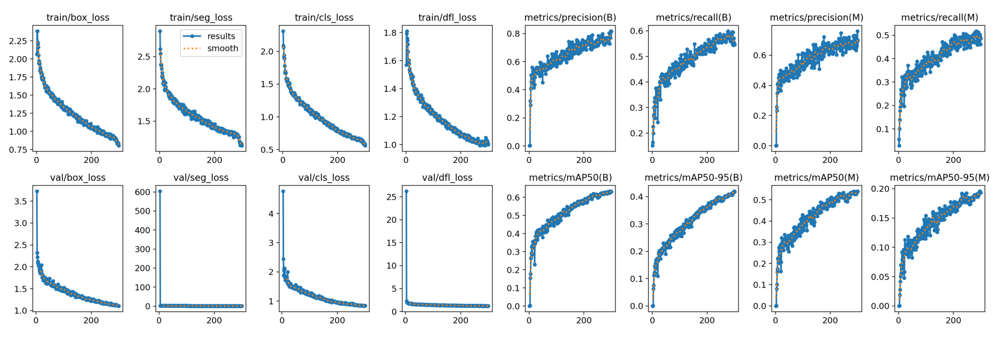

In [2]:
plot_a_plot('results/task_1/experiment_1_3/results.png')

From the above plot, it is noticeable that with more epochs, the loss could decrease further. Because most of the subplots have not plateaued. However, with the tim-constraints this is quite difficult to achieve.

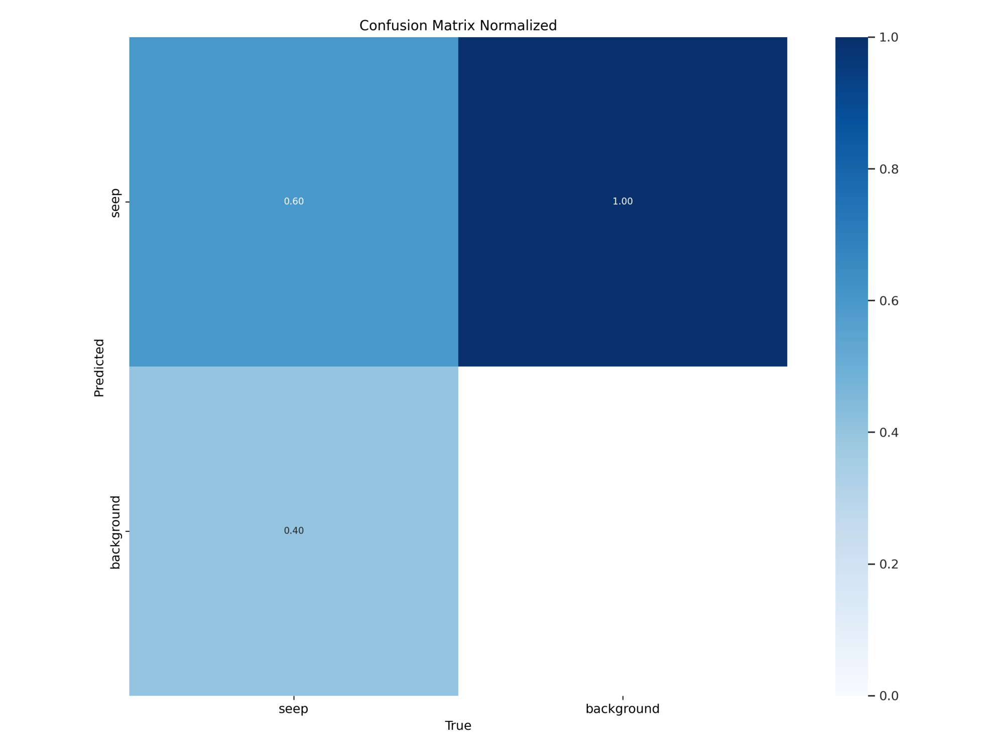

In [6]:
plot_a_plot('results/task_1/experiment_1_3/confusion_matrix_normalized.png')

From the above confusion matrix, it is clear to see that the model does classify most of the labels accurately but it still does not have a high precision or recall.

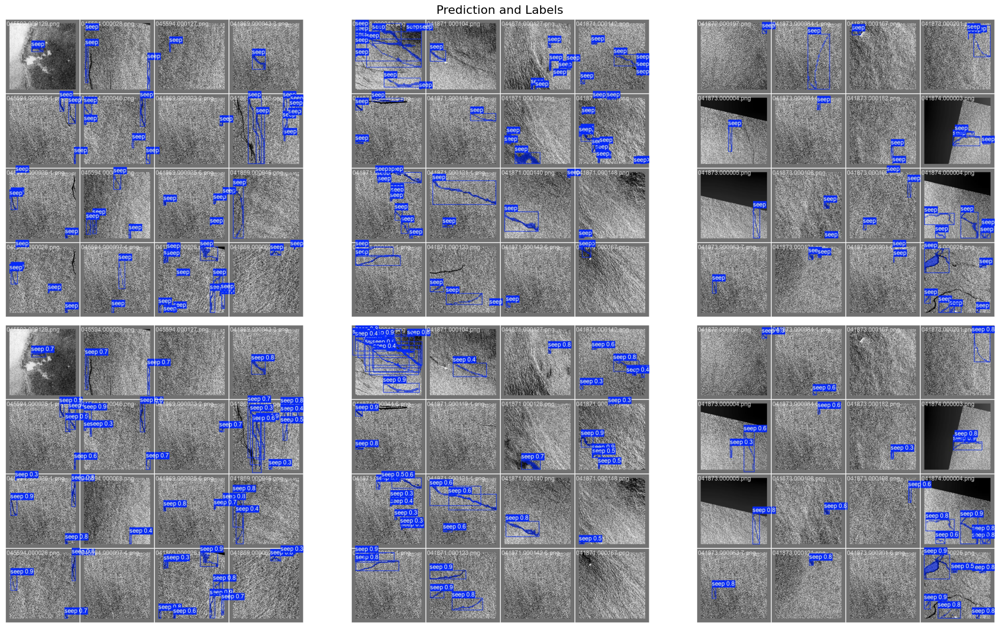

In [2]:
plot_predictions_labels('results/task_1/experiment_1_3')

From the above plot, it is clear to see that the model does a decent job of segmenting most of the seeps. It is also clear that the model gets confused with the landscape and segments other parts of the image.

## Task 2

Set number of class(nc) to 7. Instead of training from pretrained YOLO weights. Train from **Task 1** weights. Since it was trained on the same data but with different labels. So, we only train for 150 epochs.

Again, also set the initial learning rate to 0.0001 and the learning rate factor to 0.01

Repeat the in-built data augmentation like Mosaic, Mixup, Copy-Paste, Horizontal and Vertical flip. 

Set device to A100 GPU. Similarily, each epoch takes ~11 seconds

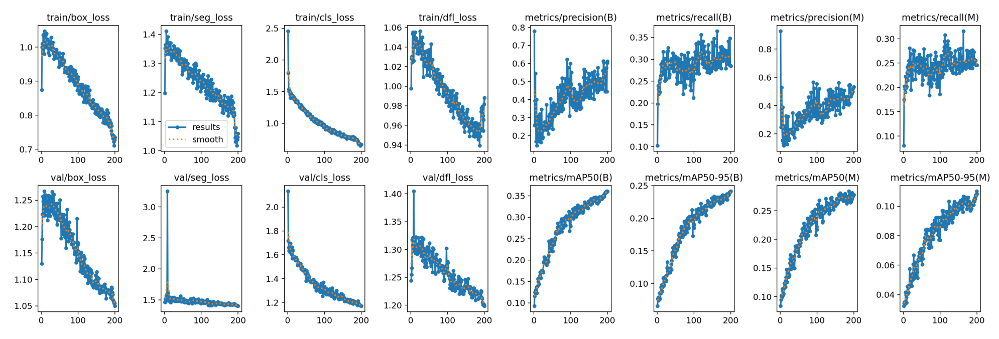

In [3]:
plot_a_plot('results/task_2/experiment_2_3/results.png')

The graphs are similar to Task 1. Wherein, it hasn't plateaued. However, it is clear to see that the training is more eratic here. This could be due to the multi-label nature of this dataset.

One interesting factor to note here is that for the first epoch some of the loss is rather low.

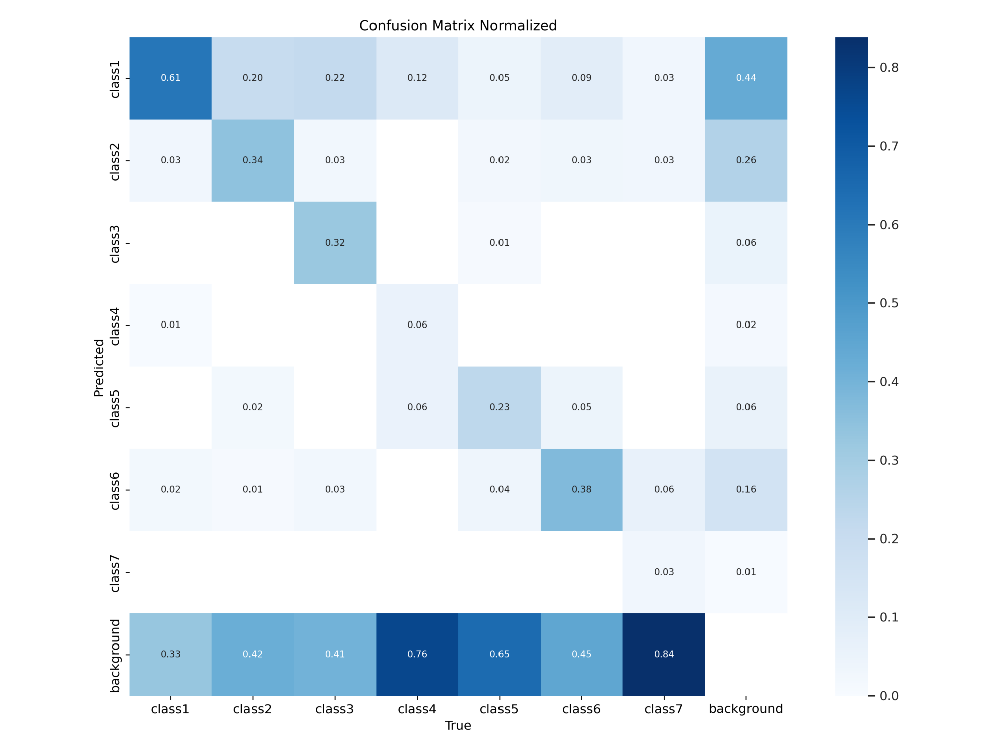

In [5]:
plot_a_plot('results/task_2/experiment_2_3/confusion_matrix_normalized.png')

Due to the imbalanced nature of the dataset, we can see how the accuracy is decent for class 1 and 6. But rather poor for the other classes.

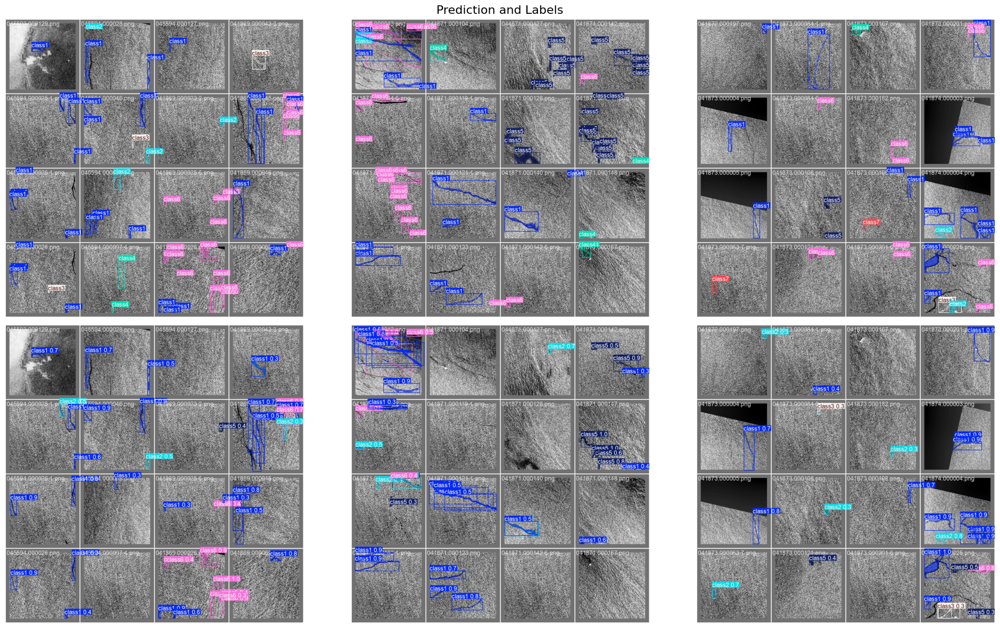

In [3]:
plot_predictions_labels('results/task_2/experiment_2_3')

There are some minimal instances where the model does not segment the seep. But overall it seems to be doing a decent job. It does seem like it misclassifies some of the seeps as 'label 1'

# 11. Evaluation(Unseen data)

The model performance for training and validation data has been noted in the above section. 

Let us see how the model performs on unseen data.

## Task 1

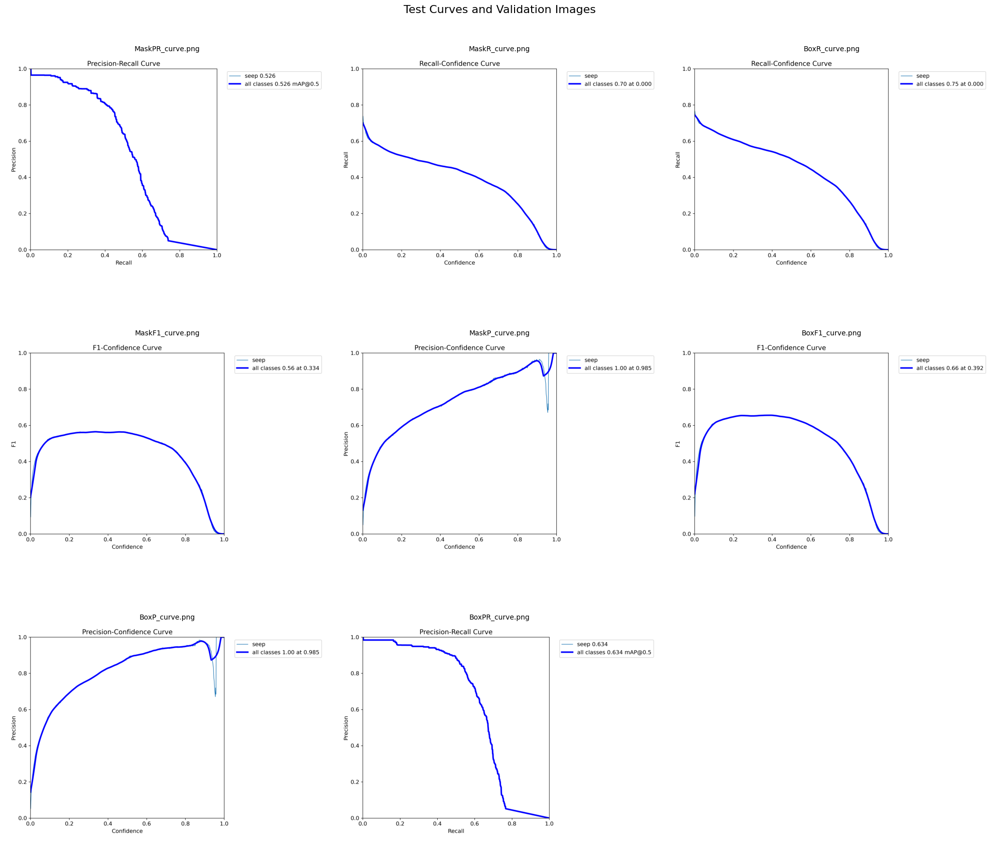

In [2]:
plot_test_curves('results/task_1/test_1_3/')

From the above plot it is discernable that the predictions are mediocre. Recall seems to be what skews the performance. More data and/or balanced data would help. But playing around with the threshold for IOU could also be helpful.

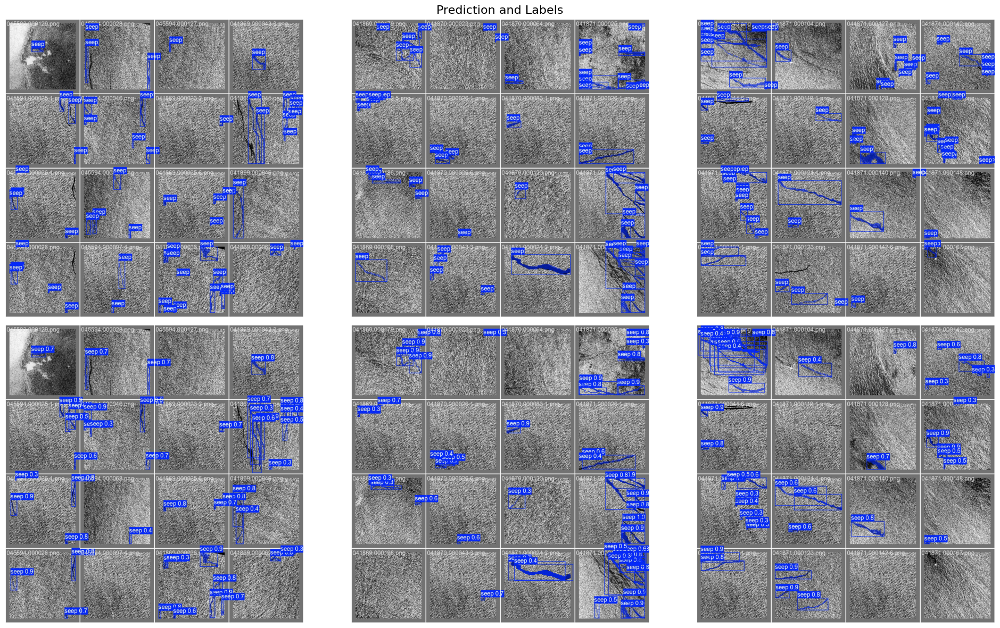

In [8]:
plot_predictions_labels('results/task_1/test_1_3')

Again, we can see the model doing a good job of segmenting seeps, it misses some of them. The confidence scores are also reasonable.

## Task 2

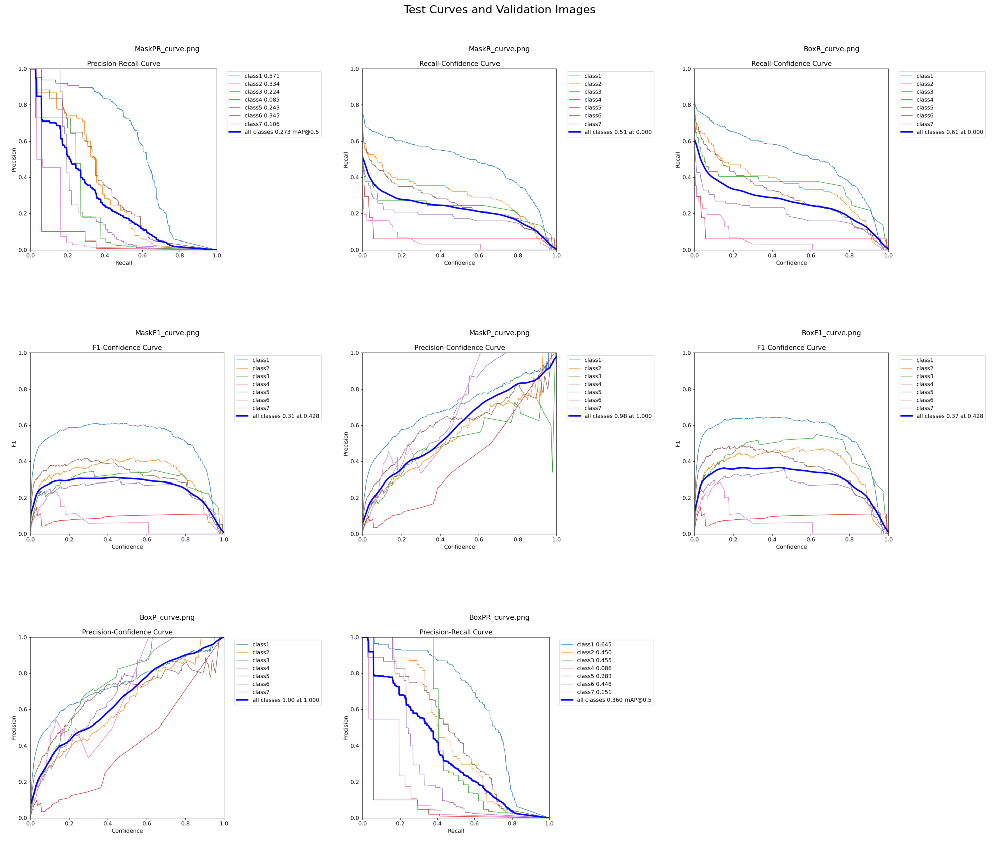

In [9]:
plot_test_curves('results/task_2/test_2_3/')

Again, we can observe that recall affects the overall accuracy. Which can be solved with a bigger and more balanced dataset. And also by playing around with IOU thresholds.

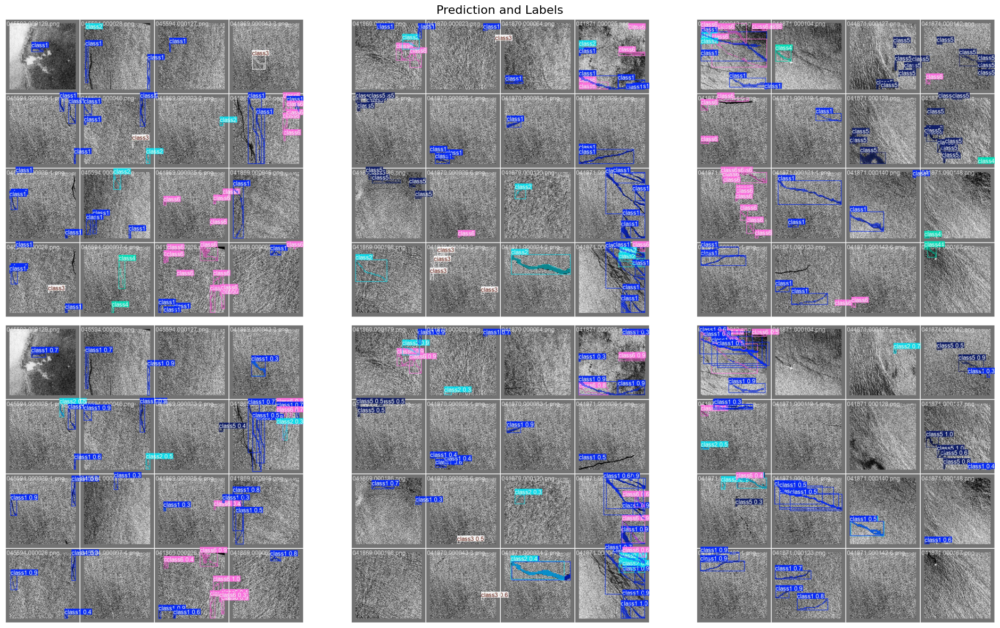

In [10]:
plot_predictions_labels('results/task_2/test_2_3')

This model seems very promising. It has detected and segmented most of the seeps. However, it could perform better with longer training, since the loss did not plateau

# 12. Conclusion

Both the models for task 1 and task 2 could use some longer training. Due to the fact that the loss did not plateau. So far, the results are somewhat promising. But additional balanced data could really help with building a more robust model.